<a href="https://colab.research.google.com/github/Hyun-Jun-Lee/EDA-Analytics-MLBHitter/blob/main/EDA%26Analytics_MLBhitter.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
from google.colab import drive 

drive.mount('/content/gdrive/')

Mounted at /content/gdrive/


In [3]:
import os
os.chdir('/content/gdrive/MyDrive/MLB/')

# Import library

In [ ]:
!pip install -U pandas-profiling

In [4]:
import numpy as np
import pandas as pd
import seaborn as sns
import pandas_profiling
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import plotly.figure_factory as ff

# Dataset edit

Colab 무료버전 제공 RAM 12.5GB

In [133]:
data = pd.read_csv('allhitters.csv')
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 129184 entries, 0 to 129183
Data columns (total 33 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   Unnamed: 0  129184 non-null  int64  
 1   name        129184 non-null  object 
 2   url         129184 non-null  object 
 3   Year        129184 non-null  int64  
 4   Age         129184 non-null  int64  
 5   Tm          129184 non-null  object 
 6   Lg          128541 non-null  object 
 7   G           128415 non-null  float64
 8   PA          126684 non-null  float64
 9   AB          126684 non-null  float64
 10  R           121198 non-null  float64
 11  H           127039 non-null  float64
 12  2B          126514 non-null  float64
 13  3B          126514 non-null  float64
 14  HR          126570 non-null  float64
 15  RBI         120278 non-null  float64
 16  SB          118903 non-null  float64
 17  CS          98164 non-null   float64
 18  BB          121212 non-null  float64
 19  SO

In [49]:
# 필요없는 columns 제거
data.drop(['url','CS','Pos','Awards','Unnamed: 0','OPS+','GDP','SF','IBB'], axis=1, inplace=True)

In [53]:
# 2021 data는 완전하지 않으므로 제거
data = data[data['Year']<2021]
data['Year'].sort_values()

43509     1871
78608     1871
39268     1871
121805    1871
50179     1871
          ... 
47670     2020
110161    2020
47654     2020
47574     2020
69257     2020
Name: Year, Length: 128083, dtype: int64

In [54]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 128083 entries, 0 to 129183
Data columns (total 24 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   name    128083 non-null  object 
 1   Year    128083 non-null  int64  
 2   Age     128083 non-null  int64  
 3   Tm      128083 non-null  object 
 4   Lg      127440 non-null  object 
 5   G       127314 non-null  float64
 6   PA      125583 non-null  float64
 7   AB      125583 non-null  float64
 8   R       120097 non-null  float64
 9   H       125938 non-null  float64
 10  2B      125413 non-null  float64
 11  3B      125413 non-null  float64
 12  HR      125469 non-null  float64
 13  RBI     119177 non-null  float64
 14  SB      117802 non-null  float64
 15  BB      120111 non-null  float64
 16  SO      113407 non-null  float64
 17  BA      125041 non-null  float64
 18  OBP     125103 non-null  float64
 19  SLG     124881 non-null  float64
 20  OPS     124881 non-null  float64
 21  TB      12

Ram 32.5+ MB -> RAM 24.4+ M

In [56]:
data.to_csv('batstat_20.csv')

# Preprocessing

In [5]:
df = pd.read_csv('batstat_20.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 128083 entries, 0 to 128082
Data columns (total 25 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   Unnamed: 0  128083 non-null  int64  
 1   name        128083 non-null  object 
 2   Year        128083 non-null  int64  
 3   Age         128083 non-null  int64  
 4   Tm          128083 non-null  object 
 5   Lg          127440 non-null  object 
 6   G           127314 non-null  float64
 7   PA          125583 non-null  float64
 8   AB          125583 non-null  float64
 9   R           120097 non-null  float64
 10  H           125938 non-null  float64
 11  2B          125413 non-null  float64
 12  3B          125413 non-null  float64
 13  HR          125469 non-null  float64
 14  RBI         119177 non-null  float64
 15  SB          117802 non-null  float64
 16  BB          120111 non-null  float64
 17  SO          113407 non-null  float64
 18  BA          125041 non-null  float64
 19  OB

## NA values check

In [6]:
df.drop(['Unnamed: 0'], axis=1, inplace=True)
df = df[df['Year']<2020]

In [7]:
df.isna().sum()

name        0
Year        0
Age         0
Tm          0
Lg        643
G         769
PA       2500
AB       2500
R        7986
H        2145
2B       2670
3B       2670
HR       2614
RBI      8906
SB      10281
BB       7972
SO      14676
BA       3037
OBP      2975
SLG      3197
OPS      3197
TB       2671
HBP     11953
SH      13150
dtype: int64

### NA 비율 10% 이상 Feature mean 값으로 대체

In [8]:
df['SH'] = df['SH'].fillna(df['SH'].mean())
df['SO'] = df['SO'].fillna(df['SO'].mean())

### NA 비율 10% 이하 Feature 0으로 대체

In [9]:
df = df.fillna(0)
df.isna().sum().sort_values()

name    0
TB      0
OPS     0
SLG     0
OBP     0
BA      0
SO      0
BB      0
SB      0
RBI     0
HR      0
3B      0
2B      0
H       0
R       0
AB      0
PA      0
G       0
Lg      0
Tm      0
Age     0
Year    0
HBP     0
SH      0
dtype: int64

## Pandas-profiling

In [70]:
profile = df.profile_report()
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## 이상치 처리

https://www.fangraphs.com/ 참고

In [11]:
# 'G', 'R', 'H'
%matplotlib inline
# 그래프 영역 나누기
f = make_subplots(rows=3, cols=1) 

# boxplot과 histogram 그래프 x,y축 지정, boxmean=평균값표시
t1 = go.Box(x=df['G'], boxmean=True, name='G')
t2 = go.Box(x=df['R'], boxmean=True, name='R')
t3 = go.Box(x=df['H'], boxmean=True, name='H')

# plotly에서는 add_trace() 함수로 지정
f.add_trace(t1, row=1, col=1) 
f.add_trace(t2, row=2, col=1)
f.add_trace(t3, row=3, col=1)

f.update_layout(height=600, width=1000, title="Outliers")

In [12]:
# 현재 경기수 162경기
df = df[df['G']<162]
df.sort_values(by='G')

,name,Year,Age,Tm,Lg,G,PA,AB,R,H,2B,3B,HR,RBI,SB,BB,SO,BA,OBP,SLG,OPS,TB,HBP,SH
13714,George Britt,1942,46,CCB,NAL,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000,0.000,0.000,0.000,0.0,0.0,2.793721
81045,Ray Moss,1935,33,BOS-NYG-WSH-min,A,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41.346359,0.000,0.000,0.000,0.000,0.0,0.0,2.793721
126956,Ray Yochim,1951,28,PIT-BOS-DET-min,AA,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41.346359,0.000,0.000,0.000,0.000,0.0,0.0,2.793721
104005,Ollie Sax,1935,30,WSH-BOS-min,AA,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41.346359,0.000,0.000,0.000,0.000,0.0,0.0,2.793721
50896,Bill Henderson,1928,26,STL-min,AA,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41.346359,0.000,0.000,0.000,0.000,0.0,0.0,2.793721
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94046,Cal Ripken Jr.,1990,29,BAL,AL,161.0,695.0,600.0,78.0,150.0,28.0,4.0,21.0,84.0,3.0,82.0,66.000000,0.250,0.341,0.415,0.756,249.0,5.0,1.000000
56194,Andruw Jones,2001,24,ATL,NL,161.0,693.0,625.0,104.0,157.0,25.0,2.0,34.0,104.0,11.0,56.0,142.000000,0.251,0.312,0.461,0.772,288.0,3.0,0.000000
94044,Cal Ripken Jr.,1988,27,BAL,AL,161.0,689.0,575.0,87.0,152.0,25.0,1.0,23.0,81.0,2.0,102.0,69.000000,0.264,0.372,0.431,0.803,248.0,2.0,0.000000
17422,Rocky Colavito,1962,28,DET,AL,161.0,707.0,601.0,90.0,164.0,30.0,2.0,37.0,112.0,2.0,96.0,68.000000,0.273,0.371,0.514,0.885,309.0,2.0,1.000000


In [13]:
# 역대 한 시즌 최다 득점 198
df = df[df['R']<198]
df.sort_values(by='G')

,name,Year,Age,Tm,Lg,G,PA,AB,R,H,2B,3B,HR,RBI,SB,BB,SO,BA,OBP,SLG,OPS,TB,HBP,SH
41907,Chappie Geygan,1931,28,SLB-min,A,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41.346359,0.000,0.000,0.000,0.000,0.0,0.0,2.793721
18294,Earl Caldwell,1954,49,MLN-min,B,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41.346359,0.000,0.000,0.000,0.000,0.0,0.0,2.793721
97232,Al Richter,1945,18,BOS-min,B,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41.346359,0.000,0.000,0.000,0.000,0.0,0.0,2.793721
43849,Ival Goodman,1947,38,CLE-min,D,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41.346359,0.000,0.000,0.000,0.000,0.0,0.0,2.793721
11489,Bob Boken,1939,31,CHW-BOS-min,AA,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41.346359,0.000,0.000,0.000,0.000,0.0,0.0,2.793721
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70880,Paul Molitor,1996,39,MIN,AL,161.0,729.0,660.0,99.0,225.0,41.0,8.0,9.0,113.0,18.0,56.0,72.000000,0.341,0.390,0.468,0.858,309.0,3.0,0.000000
102572,Ichiro Suzuki,2004,30,SEA,AL,161.0,762.0,704.0,101.0,262.0,24.0,5.0,8.0,60.0,36.0,49.0,63.000000,0.372,0.414,0.455,0.869,320.0,4.0,2.000000
104157,Paul Schaal,1971,28,KCR,AL,161.0,659.0,548.0,80.0,150.0,31.0,6.0,11.0,63.0,7.0,103.0,51.000000,0.274,0.387,0.412,0.799,226.0,2.0,0.000000
9347,Todd Benzinger,1989,26,CIN,NL,161.0,686.0,628.0,79.0,154.0,28.0,3.0,17.0,76.0,3.0,44.0,120.000000,0.245,0.293,0.381,0.674,239.0,2.0,4.000000


In [14]:
# 역대 한 시즌 최다 안타 262
df = df[df['R']<262]
df.sort_values(by='H')

,name,Year,Age,Tm,Lg,G,PA,AB,R,H,2B,3B,HR,RBI,SB,BB,SO,BA,OBP,SLG,OPS,TB,HBP,SH
19259,Duke Carmel,1965,28,NYY,AL,6.0,8.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.000000,0.0,0.000,0.0,0.000,0.0,0.0,0.000000
125298,Mike Wilson,1921,24,PIT,NL,5.0,4.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000,0.0,0.000,0.0,0.0,0.000000
7273,Skeeter Barnes,1985,28,MON-CIN-min,AAA,95.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41.346359,0.0,0.000,0.0,0.000,0.0,0.0,2.793721
15741,Andy Burns,2016,25,TOR,AL,10.0,7.0,6.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.000000,0.0,0.143,0.0,0.143,0.0,1.0,0.000000
77606,Lloyd Merriman,1955,30,CHW,AL,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000,0.0,0.000,0.0,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24060,Mays Copeland,1933,19,STL-min,A,41.0,0.0,0.0,136.0,266.0,0.0,0.0,0.0,0.0,0.0,56.0,41.346359,0.0,0.000,0.0,0.000,0.0,0.0,2.793721
36019,Harry Feldman,1939,19,NYG-min,C,40.0,0.0,0.0,127.0,272.0,0.0,0.0,0.0,0.0,0.0,117.0,41.346359,0.0,0.000,0.0,0.000,0.0,0.0,2.793721
112108,Charley Suche,1934,18,CLE-min,D,39.0,0.0,0.0,154.0,282.0,0.0,0.0,0.0,0.0,0.0,117.0,41.346359,0.0,0.000,0.0,0.000,0.0,0.0,2.793721
36335,Tom Ferrick,1937,22,NYG-min,B,38.0,0.0,0.0,133.0,288.0,0.0,0.0,0.0,0.0,0.0,99.0,41.346359,0.0,0.000,0.0,0.000,0.0,0.0,2.793721


In [15]:
# 장타율은 1을 넘을수 없음
df = df[df['SLG']<0.9]
df.sort_values(by='SLG')

,name,Year,Age,Tm,Lg,G,PA,AB,R,H,2B,3B,HR,RBI,SB,BB,SO,BA,OBP,SLG,OPS,TB,HBP,SH
30315,Robinzon Diaz,2008,24,TOR,AL,1.0,4.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.000000,0.000,0.000,0.000,0.000,0.0,0.0,0.000000
32355,Grant Dunlap,1950,26,SLB-CLE-min,"AAA,AA",1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41.346359,0.000,0.000,0.000,0.000,0.0,0.0,2.793721
75264,Jim McCloskey,1932,22,BRO-min,AA,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41.346359,0.000,0.000,0.000,0.000,0.0,0.0,2.793721
88264,Stan Papi,1980,29,BOS,AL,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000,0.000,0.000,0.000,0.0,0.0,0.000000
75261,Nat McClinic,1948,24,CBE,NAL,3.0,7.0,6.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,41.346359,0.000,0.143,0.000,0.143,0.0,0.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84881,Marcell Ozuna,2019,28,STL-min,AAA,3.0,12.0,9.0,3.0,4.0,1.0,0.0,1.0,6.0,0.0,2.0,0.000000,0.444,0.583,0.889,1.472,8.0,1.0,0.000000
37358,Cliff Floyd,2006,33,NYM-min,"A+,Rk,A-",6.0,21.0,18.0,4.0,7.0,0.0,0.0,3.0,8.0,0.0,3.0,4.000000,0.389,0.476,0.889,1.365,16.0,0.0,0.000000
96316,Hunter Renfroe,2017,25,SDP-min,AAA,14.0,61.0,55.0,18.0,28.0,7.0,1.0,4.0,18.0,1.0,6.0,7.000000,0.509,0.557,0.891,1.448,49.0,0.0,0.000000
50005,Brad Hawpe,2005,26,COL-min,AAA,7.0,34.0,28.0,7.0,13.0,3.0,0.0,3.0,11.0,0.0,6.0,7.000000,0.464,0.559,0.893,1.452,25.0,0.0,0.000000


In [16]:
# 리그가 NL, AL로 나뉘고, 현대적인 야구 규칙이 제정된 1902년 이후 데이터만 선정
df = df[df['Year']>1901]

## Preprocessing completed data

In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 119788 entries, 0 to 128082
Data columns (total 24 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   name    119788 non-null  object 
 1   Year    119788 non-null  int64  
 2   Age     119788 non-null  int64  
 3   Tm      119788 non-null  object 
 4   Lg      119788 non-null  object 
 5   G       119788 non-null  float64
 6   PA      119788 non-null  float64
 7   AB      119788 non-null  float64
 8   R       119788 non-null  float64
 9   H       119788 non-null  float64
 10  2B      119788 non-null  float64
 11  3B      119788 non-null  float64
 12  HR      119788 non-null  float64
 13  RBI     119788 non-null  float64
 14  SB      119788 non-null  float64
 15  BB      119788 non-null  float64
 16  SO      119788 non-null  float64
 17  BA      119788 non-null  float64
 18  OBP     119788 non-null  float64
 19  SLG     119788 non-null  float64
 20  OPS     119788 non-null  float64
 21  TB      11

In [20]:
df.sample(5)

,name,Year,Age,Tm,Lg,G,PA,AB,R,H,2B,3B,HR,RBI,SB,BB,SO,BA,OBP,SLG,OPS,TB,HBP,SH
38273,Herman Franks,1948,34,PHA,AL,40.0,120.0,98.0,10.0,22.0,7.0,1.0,1.0,14.0,0.0,16.0,11.0,0.224,0.345,0.347,0.692,34.0,2.0,4.0
6962,Jesse Barfield,1989,29,TOR,AL,21.0,86.0,80.0,8.0,16.0,4.0,0.0,5.0,11.0,0.0,5.0,28.0,0.200,0.256,0.438,0.693,35.0,1.0,0.0
40145,Greg Gagne,1981,19,NYY-min,A,104.0,425.0,364.0,71.0,108.0,21.0,3.0,9.0,48.0,14.0,49.0,72.0,0.297,0.379,0.445,0.824,162.0,2.0,5.0
63572,Craig Kusick,1973,24,MIN,AL,15.0,56.0,48.0,4.0,12.0,2.0,0.0,0.0,4.0,0.0,7.0,9.0,0.250,0.357,0.292,0.649,14.0,1.0,0.0
118318,Mario Valdez,2000,25,OAK,AL,5.0,12.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.000,0.000,0.000,0.000,0.0,0.0,0.0


## EDA & Analytics

### Trend Change Per Season

#### HR-SB-SH

In [18]:
hr_df = df[['HR','SB','BB','SO','G','PA','H','SH']].groupby(df['Year']).sum().reset_index()
hr_df.tail()

,Year,HR,SB,BB,SO,G,PA,H,SH
113,2015,10838.0,10191.0,40910.0,92577.0,128652.0,493337.0,117179.0,2666.793721
114,2016,11906.0,9256.0,40646.0,93276.0,123465.0,474859.0,112457.0,2163.000000
115,2017,12914.0,8115.0,40062.0,91951.0,117593.0,451951.0,106713.0,1578.793721
116,2018,11498.0,7138.0,36676.0,87096.0,109059.0,415070.0,96481.0,1257.000000
117,2019,13377.0,6027.0,34521.0,82833.0,99110.0,377781.0,88340.0,821.000000


In [165]:
fig = go.Figure()
fig.update_layout(title="Trend change per season")
fig.add_trace(go.Scatter(x=hr_df['Year'], y=hr_df['HR'], mode='lines+markers', name='HR'))
fig.add_trace(go.Scatter(x=hr_df['Year'], y=hr_df['SB'], mode='lines+markers', name='SB'))
fig.add_trace(go.Scatter(x=hr_df['Year'], y=hr_df['SH'], mode='lines+markers', name='SH'))
fig.show()

- 세이버 메트릭스를 통해 득점에 가장 효과적인 기록이 무었인지에 대한 연구가 계속 되었고, statcast 기술의 도입으로 타구 속도, 발사 각도 등을 분석할 수 있게되면서 장타의 중요성 증가 -> 홈런의 수가 급격히 증가중
- 그에 비해 도루, 희생번트는 기대득점이 낮고, 특히 도루는 부상위험이 크기 때문에 시도 및 성공횟수가 줄어드는 추세
    - 세이버메트릭스에 따르면 무사 1,2루 상황에서의 희생 번트만 가치가 있음


#### ISO-k%-BB/K

In [19]:
hr_df['HR_per_PA'] = hr_df['HR'] / hr_df['PA'] * 100
hr_df['BB/K'] = hr_df['BB'] / hr_df['SO']
hr_df['K%'] = (hr_df['SO'] / hr_df['PA']) * 100
hr_df.sample(5)

,Year,HR,SB,BB,SO,G,PA,H,SH,HR_per_PA,BB/K,K%
24,1926,1387.0,2410.0,10604.0,15797.204193,34550.0,130187.0,32822.0,4044.255578,1.065391,0.671258,12.134241
9,1911,518.0,3497.0,7732.0,8288.000000,23215.0,89706.0,21383.0,2715.000000,0.577442,0.932915,9.239070
27,1929,2128.0,2225.0,10883.0,15843.550552,35628.0,136276.0,36285.0,3549.242085,1.561537,0.686904,11.626075
15,1917,343.0,2537.0,6902.0,7298.000000,24490.0,90232.0,20317.0,2923.000000,0.380131,0.945739,8.088040
75,1977,7429.0,8534.0,34164.0,46361.156302,95110.0,350426.0,84628.0,2893.524650,2.119991,0.736910,13.229942


In [20]:
avg_df = df[['BA','OBP','SLG','OPS']].groupby(df['Year']).mean().reset_index().round(3)
avg_df['ISO'] = avg_df['SLG'] - avg_df['BA']
avg_df.head()

,Year,BA,OBP,SLG,OPS,ISO
0,1902,0.252,0.307,0.319,0.626,0.067
1,1903,0.240,0.304,0.312,0.605,0.072
2,1904,0.222,0.276,0.285,0.561,0.063
3,1905,0.226,0.283,0.290,0.573,0.064
4,1906,0.227,0.285,0.285,0.569,0.058


In [21]:
f = make_subplots(rows=3, cols=1)
# Create and style traces
t1 = go.Scatter(x=avg_df['Year'], y=avg_df['ISO'], name='ISO',
                         line=dict(color='firebrick', width=4))
t2 = go.Scatter(x=hr_df['Year'], y=hr_df['K%'], name='K%',
                         line=dict(color='blue', width=4))
t3 = go.Scatter(x=hr_df['Year'], y=hr_df['BB/K'], name='BB/K',
                         line=dict(color='green', width=4))

f.add_trace(t1, row=1, col=1) 
f.add_trace(t2, row=2, col=1)
f.add_trace(t3, row=3, col=1)

- ISO : 장타율 - 타율, 절대적인 타자의 파워를 나타내는 지수<br>
- K% : 타석당 삼진 비율<br>
- BB/K : 삼진 한개 당 볼넷의 수, 타자의 선구안을 판단하는 지표<br><br>

ISO 그래프를 통해 타자들이 공을 강하게 타격하려고 하는 것을 알수 있다.<br>
K%, BB/K를 통해 강하게 타격함에따라 스윙이 커져서 타석당 헛스윙 비율 증가하고 볼넷 비율이 줄어듬을 알 수 있다.


### Who is The Strongest Hitter in 00s?

#### 연도별 기록으로 정리

In [22]:
# 연도 설정
df_00 = df[df['Year']>1999]
df_00 = df_00[df_00['Year']<2010]

# 기록 정리 위해 분리
df_00_sum = df_00[['name','G','PA','H','2B','3B','HR','BB','SO','SH']]
df_00_sum = df_00_sum.groupby(by='name').sum().reset_index()
df_00_mean = df_00[['name','BA','OBP','SLG','OPS']]
df_00_mean = df_00_mean.groupby(by='name').mean().reset_index().round(3)

# 다시 합치기

df2000 = pd.merge(df_00_sum, df_00_mean, how='inner', on='name').round(3)
df2000.sample(5)

,name,G,PA,H,2B,3B,HR,BB,SO,SH,BA,OBP,SLG,OPS
332,Casey Kotchman,1120.0,4315.0,1097.0,255.0,7.0,95.0,386.0,379.0,7.0,0.255,0.337,0.376,0.713
2025,Willy Taveras,1095.0,4588.0,1149.0,126.0,33.0,20.0,314.0,715.0,71.0,0.263,0.321,0.316,0.636
1587,Paul Hoover,797.0,2908.0,656.0,162.0,18.0,40.0,248.0,613.0,22.0,0.296,0.341,0.381,0.722
1062,John Valentin,157.0,408.0,82.0,20.0,0.0,8.0,42.0,57.0,1.0,0.230,0.324,0.371,0.695
1603,Pedro Valdes,122.0,465.0,132.0,35.0,2.0,17.0,51.0,48.0,0.0,0.305,0.378,0.495,0.874


#### Create Feature

In [23]:
df2000['ISO'] = df2000['SLG'] - df2000['BA']
df2000['HR_per_PA'] = df2000['HR'] / df2000['PA'] * 100
df2000['BB/K'] = df2000['BB'] / df2000['SO']
df2000['K%'] = (df2000['SO'] / df2000['PA']) * 100
df2000 = df2000.round(3)
df2000.sample(5)

,name,G,PA,H,2B,3B,HR,BB,SO,SH,BA,OBP,SLG,OPS,ISO,HR_per_PA,BB/K,K%
624,Drew Sutton,645.0,2747.0,647.0,146.0,13.0,67.0,341.0,464.0,32.0,0.268,0.367,0.422,0.789,0.154,2.439,0.735,16.891
789,Greg Blosser,18.0,52.0,7.0,3.0,0.0,0.0,7.0,9.0,0.0,0.159,0.269,0.227,0.497,0.068,0.000,0.778,17.308
1786,Scott Brosius,257.0,1002.0,232.0,45.0,2.0,29.0,80.0,156.0,6.0,0.256,0.347,0.357,0.704,0.101,2.894,0.513,15.569
825,Herbert Perry,533.0,1961.0,502.0,113.0,5.0,59.0,125.0,303.0,8.0,0.276,0.330,0.406,0.736,0.130,3.009,0.413,15.451
563,David Ross,897.0,2952.0,606.0,130.0,10.0,116.0,315.0,730.0,36.0,0.236,0.328,0.405,0.733,0.169,3.930,0.432,24.729


#### Top 5 Homerun Leader

In [24]:
top5_00_hr = df2000.sort_values(by='HR', ascending=False).head(5)
top5_00_hr

,name,G,PA,H,2B,3B,HR,BB,SO,SH,BA,OBP,SLG,OPS,ISO,HR_per_PA,BB/K,K%
18,Adam Dunn,1664.0,7028.0,1458.0,304.0,9.0,404.0,1197.0,1780.0,3.0,0.256,0.392,0.526,0.918,0.270,5.748,0.672,25.327
1013,Jim Thome,1502.0,6153.0,1352.0,247.0,8.0,392.0,1054.0,1558.0,0.0,0.264,0.398,0.506,0.903,0.242,6.371,0.677,25.321
1332,Manny Ramirez,1527.0,6580.0,1751.0,365.0,12.0,387.0,926.0,1223.0,0.0,0.305,0.418,0.578,0.996,0.273,5.881,0.757,18.587
44,Albert Pujols,1532.0,6626.0,1871.0,428.0,21.0,385.0,857.0,617.0,2.0,0.332,0.422,0.620,1.042,0.288,5.810,1.389,9.312
910,Jason Giambi,1424.0,5808.0,1244.0,240.0,5.0,319.0,1015.0,1056.0,0.0,0.265,0.411,0.505,0.917,0.240,5.492,0.961,18.182


In [25]:
fig = px.funnel(top5_00_hr, x='HR',y='name',title="Top5 HR in 00s")
fig.show()

#### Toy 5 Leader detail stat

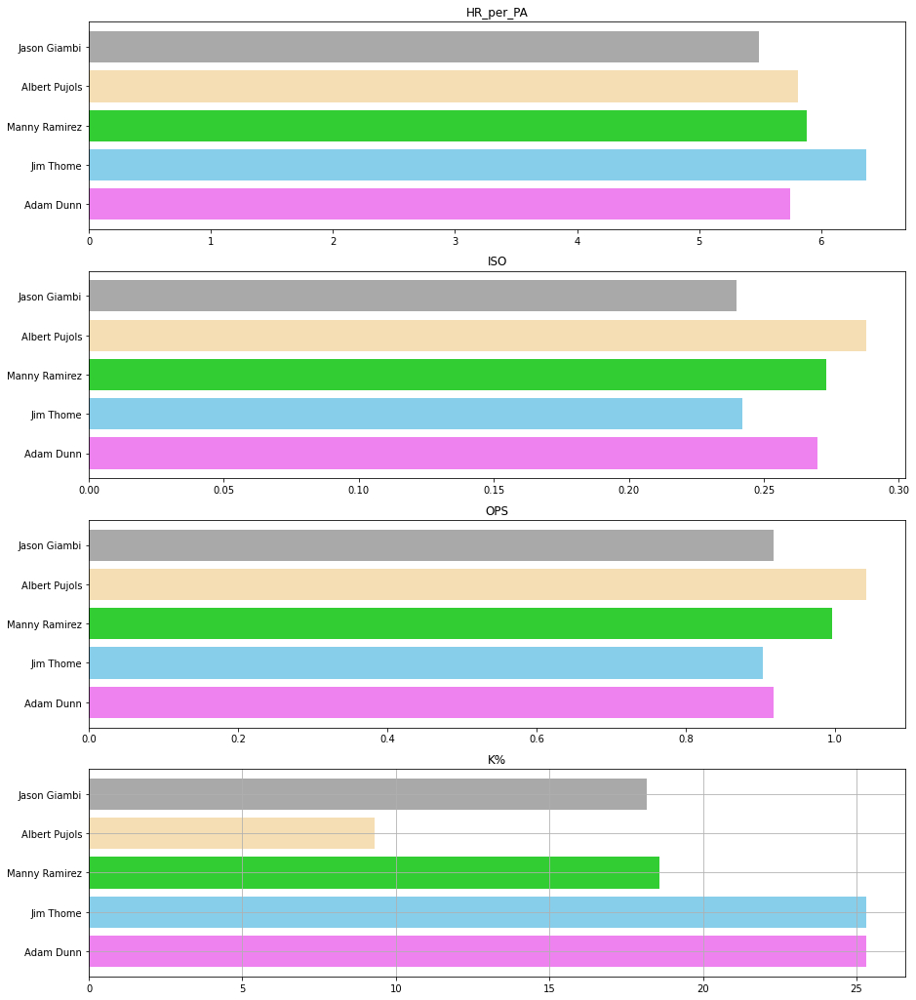

In [121]:
%matplotlib inline

plt.figure(figsize=(15,18))

plt.subplot(4,1,1)
plt.barh(top5_00_hr['name'], top5_00_hr['HR_per_PA'], color=['violet','skyblue','limegreen','wheat','darkgray'])
plt.title('HR_per_PA')

plt.subplot(4,1,2)
plt.barh(top5_00_hr['name'], top5_00_hr['ISO'], color=['violet','skyblue','limegreen','wheat','darkgray'])
plt.title('ISO')

plt.subplot(4,1,3)
plt.barh(top5_00_hr['name'], top5_00_hr['OPS'], color=['violet','skyblue','limegreen','wheat','darkgray'])
plt.title('OPS')

plt.subplot(4,1,4)
plt.barh(top5_00_hr['name'], top5_00_hr['K%'], color=['violet','skyblue','limegreen','wheat','darkgray'])
plt.title('K%')

plt.grid()
plt.show()

#### My choice is **Albert Pujols**

- 선정이유

1. 총 홈런 개수는 4등이지만,ISO(순수장타율)는 `0.288`로 1등
2. K% : `9.3%` & BB/K : `1.3` -> 다른 타자와 비교해 압도적인 수치, 파워와 함께 선구안도 갖추었다고 볼수 있음
3. 타/출/장/OPS = `0.332/0.422/0.620/1.042` -> 역사상 최고의 10년이라고 뽑을 수 있을만한 아름다운 기본 Stat


- 수상기록
    - MVP : Most Valuable Player x3
    - RoY : Rookie of the Year
    - AS : All-Star x8
    - GG : Gold Glove
    - SS : Silver Slugger(포지션 내 최고 타자) x5


In [145]:
Pujols = data[(data['name']=='Albert Pujols')&(data['Year']<2010)]
Pujols[['Year', 'Age','Awards']]

,Year,Age,Awards
88470,2000,20,"PEO,POT,MEM · MIDW,CARL,PCL"
88471,2001,21,"AS,MVP-4,RoY-1,SS"
88472,2002,22,MVP-2
88473,2003,23,"AS,MVP-2,SS"
88474,2004,24,"AS,MVP-3,SS"
88475,2005,25,"AS,MVP-1"
88476,2006,26,"AS,MVP-2,GG"
88477,2007,27,"AS,MVP-9"
88478,2008,28,"AS,MVP-1,SS"
88479,2009,29,"AS,MVP-1,SS"


### Who is The Strongest Hitter in 10s?

In [123]:
# 연도 설정
df_10 = df[df['Year']>2010]

# 기록 정리 위해 분리
df_10_sum = df_10[['name','G','PA','H','2B','3B','HR','BB','SO','SH']]
df_10_sum = df_10_sum.groupby(by='name').sum().reset_index()
df_10_mean = df_10[['name','BA','OBP','SLG','OPS']]
df_10_mean = df_10_mean.groupby(by='name').mean().reset_index().round(3)

# 다시 합치기

df2010 = pd.merge(df_10_sum, df_10_mean, how='inner', on='name').round(3)
df2010.sample(5)

,name,G,PA,H,2B,3B,HR,BB,SO,SH,BA,OBP,SLG,OPS
1653,Tug Hulett,193.0,718.0,179.0,38.0,5.0,10.0,76.0,123.0,3.0,0.285,0.360,0.408,0.768
297,Carlos Tocci,679.0,2740.0,668.0,100.0,22.0,16.0,164.0,445.0,31.0,0.262,0.319,0.337,0.656
1533,Seth Smith,910.0,3172.0,717.0,178.0,21.0,90.0,335.0,639.0,1.0,0.308,0.392,0.461,0.854
772,Jarrod Dyson,962.0,3086.0,687.0,87.0,40.0,23.0,269.0,486.0,54.0,0.248,0.329,0.320,0.649
371,Clint Barmes,561.0,1809.0,381.0,85.0,2.0,30.0,99.0,357.0,23.0,0.246,0.299,0.344,0.643


#### Create Feature

In [124]:
df2010['ISO'] = df2010['SLG'] - df2010['BA']
df2010['HR_per_PA'] = df2010['HR'] / df2010['PA'] * 100
df2010['BB/K'] = df2010['BB'] / df2010['SO']
df2010['K%'] = (df2010['SO'] / df2010['PA']) * 100
df2010 = df2010.round(3)
df2010.sample(5)

,name,G,PA,H,2B,3B,HR,BB,SO,SH,BA,OBP,SLG,OPS,ISO,HR_per_PA,BB/K,K%
1678,Tzu-Wei Lin,703.0,2821.0,624.0,116.0,25.0,23.0,264.0,492.0,25.0,0.247,0.322,0.345,0.667,0.098,0.815,0.537,17.441
643,Gilberto Celestino,248.0,1065.0,266.0,50.0,6.0,19.0,88.0,190.0,2.0,0.277,0.340,0.398,0.738,0.121,1.784,0.463,17.840
1160,Matt Clark,518.0,2092.0,534.0,107.0,4.0,94.0,215.0,440.0,1.0,0.272,0.340,0.513,0.852,0.241,4.493,0.489,21.033
886,Johnny Damon,214.0,871.0,198.0,35.0,9.0,20.0,68.0,119.0,2.0,0.242,0.304,0.374,0.676,0.132,2.296,0.571,13.662
873,John Baker,239.0,767.0,138.0,21.0,2.0,4.0,80.0,178.0,5.0,0.192,0.290,0.248,0.537,0.056,0.522,0.449,23.207


#### Top 5 Homerun Leader

In [140]:
top5_10_hr = df2010.sort_values(by='HR', ascending=False).head(5)
top5_10_hr

,name,G,PA,H,2B,3B,HR,BB,SO,SH,BA,OBP,SLG,OPS,ISO,HR_per_PA,BB/K,K%
545,Edwin Encarnacion,1379.0,5904.0,1333.0,253.0,5.0,349.0,718.0,1025.0,0.0,0.250,0.337,0.490,0.827,0.240,5.911,0.700,17.361
796,Jay Bruce,1651.0,6662.0,1459.0,326.0,30.0,340.0,581.0,1571.0,2.0,0.232,0.292,0.452,0.744,0.220,5.104,0.370,23.582
1285,Nelson Cruz,1285.0,5400.0,1343.0,245.0,6.0,327.0,476.0,1225.0,0.0,0.283,0.347,0.534,0.881,0.251,6.056,0.389,22.685
711,J.D. Martinez,1334.0,5533.0,1467.0,304.0,22.0,302.0,494.0,1306.0,0.0,0.285,0.340,0.537,0.877,0.252,5.458,0.378,23.604
1261,Mike Trout,1314.0,5792.0,1472.0,274.0,65.0,297.0,863.0,1212.0,5.0,0.302,0.421,0.570,0.991,0.268,5.128,0.712,20.925


In [141]:
fig = px.funnel(top5_10_hr, x='HR',y='name',title="Top5 HR in 00s")
fig.show()

#### Toy 5 Leader detail stat

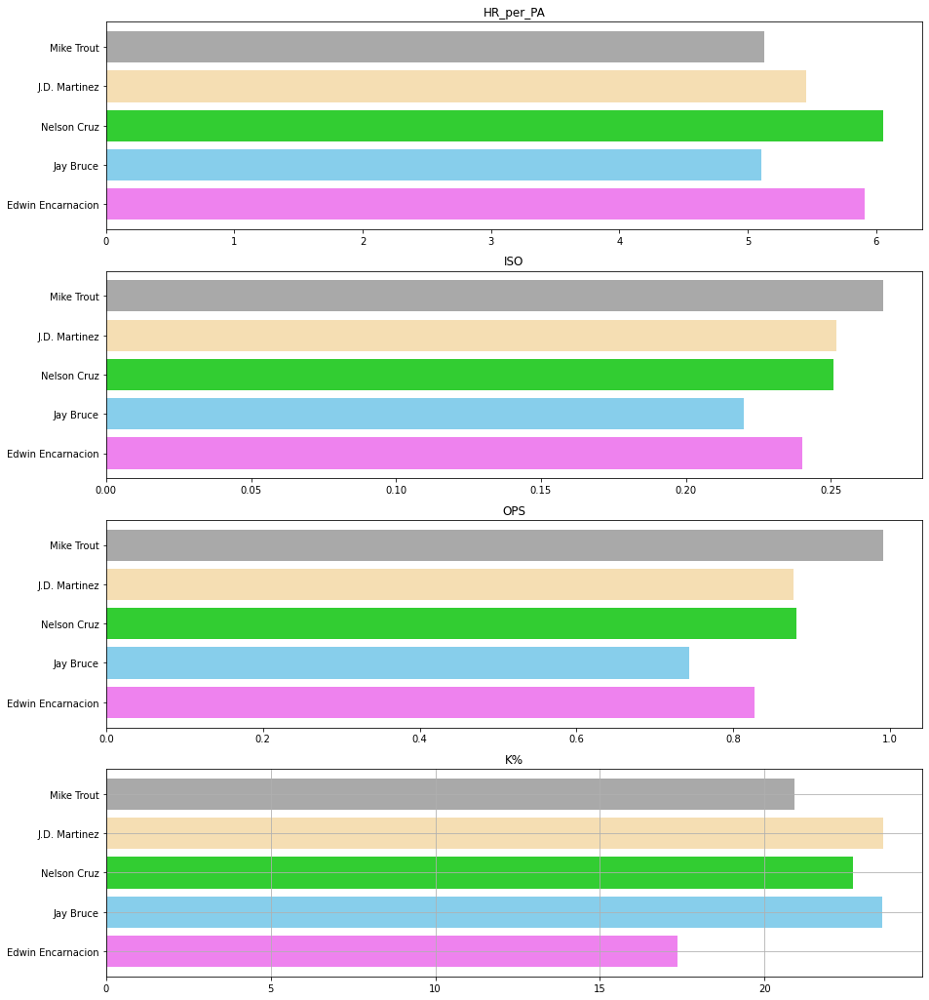

In [142]:
%matplotlib inline

plt.figure(figsize=(15,18))

plt.subplot(4,1,1)
plt.barh(top5_10_hr['name'], top5_10_hr['HR_per_PA'], color=['violet','skyblue','limegreen','wheat','darkgray'])
plt.title('HR_per_PA')

plt.subplot(4,1,2)
plt.barh(top5_10_hr['name'], top5_10_hr['ISO'], color=['violet','skyblue','limegreen','wheat','darkgray'])
plt.title('ISO')

plt.subplot(4,1,3)
plt.barh(top5_10_hr['name'], top5_10_hr['OPS'], color=['violet','skyblue','limegreen','wheat','darkgray'])
plt.title('OPS')

plt.subplot(4,1,4)
plt.barh(top5_10_hr['name'], top5_10_hr['K%'], color=['violet','skyblue','limegreen','wheat','darkgray'])
plt.title('K%')

plt.grid()
plt.show()

#### My choice is is **Mike Trout**

- 선정이유

1. 총 홈런 개수는 5등이지만,ISO(순수장타율)는 `0.268`로 1등
2. OBP : `0.421` -> 데이터 야구 시대에서 중요시 여겨지고 평균적으로 가장 기복이 없다고 여겨지는 Stat
3. BB : `863` -> 타 선수 대비 압도적 기록, 타격에 기복이 있을시에도 꾸준히 활약해 줄 수 있는 부분 
4. 3B : `65` -> 장타력 뿐만 아니라, 스피드 까지 갖추었음
5. 타/출/장/OPS = `0.302/0.421/0.570/0.991` -> 약점에 대해 세밀한 분석이 되고, 투수들의 기술이 빠르게 향상되고 있는 현대 야구에서 엄청난 기본 Stat


- 수상기록
    - MVP : Most Valuable Player x3
    - RoY : Rookie of the Year
    - AS : All-Star x9
    - SS : Silver Slugger(포지션 내 최고 타자) x8

In [148]:
Trout = data[(data['name']=='Mike Trout')&(data['Year']>2009)]
Trout[['Year', 'Age','Awards']]

,Year,Age,Awards
114481,2010,18,"CDR,RCU · MIDW,CALL"
114482,2011,19,ARK · TL
114483,2011,19,NaN
114484,2012,20,SLK · PCL
114485,2012,20,"AS,MVP-2,RoY-1,SS"
114486,2013,21,"AS,MVP-2,SS"
114487,2014,22,"AS,MVP-1,SS"
114488,2015,23,"AS,MVP-2,SS"
114489,2016,24,"AS,MVP-1,SS"
114490,2017,25,SBR · CALL


### Albert Pujols vs Mike Trout

#### Comparison by age


In [223]:
# 데이터 concat
vs_df = pd.concat([Pujols,Trout])

# 필요없는 column 제거 및 na 처리
vs_df.drop(['Unnamed: 0','url','Lg','SH','SF','IBB','Pos','Awards','CS','TB','HBP'], axis=1,inplace=True)
vs_df = vs_df.reset_index()
vs_df = vs_df.drop(['index'], axis=1)
vs_df = vs_df.fillna(0)

# 마이너 리그 기록 제거
vs_df = vs_df[vs_df['OPS+']>0]
vs_df = vs_df[vs_df['Year']<2020]

# columns 추가
vs_df['BB/K'] = (vs_df['BB'] / vs_df['SO'])
vs_df['ISO'] = vs_df['SLG'] - vs_df['BA']

vs_df = vs_df.round(3)
vs_df

,name,Year,Age,Tm,G,PA,AB,R,H,2B,3B,HR,RBI,SB,BB,SO,BA,OBP,SLG,OPS,OPS+,GDP,BB/K,ISO
1,Albert Pujols,2001,21,STL,161.0,676.0,590.0,112.0,194.0,47.0,4.0,37.0,130.0,1.0,69.0,93.0,0.329,0.403,0.610,1.013,157.0,21.0,0.742,0.281
2,Albert Pujols,2002,22,STL,157.0,675.0,590.0,118.0,185.0,40.0,2.0,34.0,127.0,2.0,72.0,69.0,0.314,0.394,0.561,0.955,151.0,20.0,1.043,0.247
3,Albert Pujols,2003,23,STL,157.0,685.0,591.0,137.0,212.0,51.0,1.0,43.0,124.0,5.0,79.0,65.0,0.359,0.439,0.667,1.106,187.0,13.0,1.215,0.308
4,Albert Pujols,2004,24,STL,154.0,692.0,592.0,133.0,196.0,51.0,2.0,46.0,123.0,5.0,84.0,52.0,0.331,0.415,0.657,1.072,173.0,21.0,1.615,0.326
5,Albert Pujols,2005,25,STL,161.0,700.0,591.0,129.0,195.0,38.0,2.0,41.0,117.0,16.0,97.0,65.0,0.330,0.430,0.609,1.039,168.0,19.0,1.492,0.279
6,Albert Pujols,2006,26,STL,143.0,634.0,535.0,119.0,177.0,33.0,1.0,49.0,137.0,7.0,92.0,50.0,0.331,0.431,0.671,1.102,178.0,20.0,1.840,0.340
7,Albert Pujols,2007,27,STL,158.0,679.0,565.0,99.0,185.0,38.0,1.0,32.0,103.0,2.0,99.0,58.0,0.327,0.429,0.568,0.997,157.0,27.0,1.707,0.241
8,Albert Pujols,2008,28,STL,148.0,641.0,524.0,100.0,187.0,44.0,0.0,37.0,116.0,7.0,104.0,54.0,0.357,0.462,0.653,1.114,192.0,16.0,1.926,0.296
9,Albert Pujols,2009,29,STL,160.0,700.0,568.0,124.0,186.0,45.0,1.0,47.0,135.0,16.0,115.0,64.0,0.327,0.443,0.658,1.101,189.0,23.0,1.797,0.331
12,Mike Trout,2011,19,LAA,40.0,135.0,123.0,20.0,27.0,6.0,0.0,5.0,16.0,4.0,9.0,30.0,0.220,0.281,0.390,0.672,89.0,2.0,0.300,0.170


##### vs OPS+

In [208]:
fig = px.line(vs_df, x='Age',y='OPS+',color='name',text='OPS+', title='vs OPS+')
fig.update_traces(textposition="bottom right")
fig.show()

- OPS+ : 리그 수준의 차이나 다른시기에 활동 했던 타자들의 경우를 비교하기 위해 만들어진 리그 평균의 생산력 OPS 지표
    - ex) OPS+=150 -> 해당 시즌 리그 평균에 비해 1.5배 우수한 OPS

##### vs HR

In [211]:
fig = px.bar(vs_df, x='Age',y='HR',color='name',text='HR', title='vs HR')
fig.update_traces(textposition="inside")
fig.show()

##### vs ISO

In [224]:
fig = px.line(vs_df, x='Age',y='ISO',color='name',text='ISO', title='vs ISO')
fig.update_traces(textposition="bottom right")
fig.show()

#### Comparison by Accumulated stat

In [263]:
# 기록 정리 위해 분리
vs_df_sum = vs_df[['name','G','PA','H','2B','3B','HR','BB','SO','GDP']]
vs_df_sum = vs_df_sum.groupby(by='name').sum().reset_index()
vs_df_mean = vs_df[['name','BA','OBP','SLG','OPS','BB/K','ISO']]
vs_df_mean = vs_df_mean.groupby(by='name').mean().reset_index().round(3)

# 다시 합치기

vs_df_acc = pd.merge(vs_df_sum, vs_df_mean, how='inner', on='name').round(3)
vs_df_acc

,name,G,PA,H,2B,3B,HR,BB,SO,GDP,BA,OBP,SLG,OPS,BB/K,ISO
0,Albert Pujols,1399.0,6082.0,1717.0,387.0,14.0,366.0,811.0,570.0,180.0,0.334,0.427,0.628,1.055,1.486,0.294
1,Mike Trout,1199.0,5273.0,1324.0,251.0,46.0,285.0,803.0,1118.0,57.0,0.298,0.408,0.568,0.976,0.713,0.271
